Name: Anmol Singhal
Roll No: 11940140

References:

1. https://towardsdatascience.com/comparing-sample-distributions-with-the-kolmogorov-smirnov-ks-test-a2292ad6fee5

# Question 2: Life Expectancy (WHO)

The objective of this ipynb notebook is to answer the following questions:

1. Feature Selection: Do various predicting factors which have been chosen initially really affect the Life expectancy? What are the predicting variables actually affecting life expectancy?


2. Should a country having a lower life expectancy value (<65) increase its healthcare expenditure in order to improve its average lifespan?


3. How do Infant and Adult mortality rates affect life expectancy?


4. Does Life Expectancy have positive or negative correlation with eating habits, lifestyle, exercise, smoking, drinking alcohol etc.


5. What is the impact of schooling on the lifespan of humans?


6. Does Life Expectancy have a positive or negative relationship with drinking alcohol?


7. Do densely populated countries tend to have lower life expectancy?


8. What is the impact of Immunization coverage on life Expectancy?

### Importing Libraries

In [1]:
import pandas as pd 
import numpy as np
import math
import os
import plotly.express as px
import seaborn as sns
from collections import Counter
from scipy import stats
from sklearn.impute import KNNImputer
from numpy.linalg import linalg
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv('./Life Expectancy Data.csv')
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy ', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles ', ' BMI ', 'under-five deaths ', 'Polio', 'Total expenditure',
       'Diphtheria ', ' HIV/AIDS', 'GDP', 'Population',
       ' thinness  1-19 years', ' thinness 5-9 years',
       'Income composition of resources', 'Schooling'],
      dtype='object')

Let's corrected the misspaced column headings

In [109]:
df.columns = df.columns.str.strip()
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'],
      dtype='object')

In [110]:
print(f"Shape of data: {df.shape}")
df.head()

Shape of data: (2938, 22)


,Country,Year,Status,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
0,Afghanistan,2015,Developing,65.0,263.0,62,0.01,71.279624,65.0,1154,...,6.0,8.16,65.0,0.1,584.259210,33736494.0,17.2,17.3,0.479,10.1
1,Afghanistan,2014,Developing,59.9,271.0,64,0.01,73.523582,62.0,492,...,58.0,8.18,62.0,0.1,612.696514,327582.0,17.5,17.5,0.476,10.0
2,Afghanistan,2013,Developing,59.9,268.0,66,0.01,73.219243,64.0,430,...,62.0,8.13,64.0,0.1,631.744976,31731688.0,17.7,17.7,0.470,9.9
3,Afghanistan,2012,Developing,59.5,272.0,69,0.01,78.184215,67.0,2787,...,67.0,8.52,67.0,0.1,669.959000,3696958.0,17.9,18.0,0.463,9.8
4,Afghanistan,2011,Developing,59.2,275.0,71,0.01,7.097109,68.0,3013,...,68.0,7.87,68.0,0.1,63.537231,2978599.0,18.2,18.2,0.454,9.5


In [111]:
df.describe()

,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938.000000,2928.000000,2928.000000,2938.000000,2744.000000,2938.000000,2385.000000,2938.000000,2904.000000,2938.000000,2919.000000,2712.00000,2919.000000,2938.000000,2490.000000,2.286000e+03,2904.000000,2904.000000,2771.000000,2775.000000
mean,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,42.035739,82.550188,5.93819,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,4.613841,9.523867,124.292079,117.926501,4.052413,1987.914858,25.070016,11467.272489,20.044034,160.445548,23.428046,2.49832,23.716912,5.077785,14270.169342,6.101210e+07,4.420195,4.508882,0.210904,3.358920
min,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,0.37000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,2004.000000,63.100000,74.000000,0.000000,0.877500,4.685343,77.000000,0.000000,19.300000,0.000000,78.000000,4.26000,78.000000,0.100000,463.935626,1.957932e+05,1.600000,1.500000,0.493000,10.100000
50%,2008.000000,72.100000,144.000000,3.000000,3.755000,64.912906,92.000000,17.000000,43.500000,4.000000,93.000000,5.75500,93.000000,0.100000,1766.947595,1.386542e+06,3.300000,3.300000,0.677000,12.300000
75%,2012.000000,75.700000,228.000000,22.000000,7.702500,441.534144,97.000000,360.250000,56.200000,28.000000,97.000000,7.49250,97.000000,0.800000,5910.806335,7.420359e+06,7.200000,7.200000,0.779000,14.300000
max,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,2500.000000,99.000000,17.60000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


In [112]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2938 entries, 0 to 2937
Data columns (total 22 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Country                          2938 non-null   object 
 1   Year                             2938 non-null   int64  
 2   Status                           2938 non-null   object 
 3   Life expectancy                  2928 non-null   float64
 4   Adult Mortality                  2928 non-null   float64
 5   infant deaths                    2938 non-null   int64  
 6   Alcohol                          2744 non-null   float64
 7   percentage expenditure           2938 non-null   float64
 8   Hepatitis B                      2385 non-null   float64
 9   Measles                          2938 non-null   int64  
 10  BMI                              2904 non-null   float64
 11  under-five deaths                2938 non-null   int64  
 12  Polio               

Let's also find the NAN values

In [113]:
df.isna().sum()

Country                              0
Year                                 0
Status                               0
Life expectancy                     10
Adult Mortality                     10
infant deaths                        0
Alcohol                            194
percentage expenditure               0
Hepatitis B                        553
Measles                              0
BMI                                 34
under-five deaths                    0
Polio                               19
Total expenditure                  226
Diphtheria                          19
HIV/AIDS                             0
GDP                                448
Population                         652
thinness  1-19 years                34
thinness 5-9 years                  34
Income composition of resources    167
Schooling                          163
dtype: int64

Let's convert the zero values to NAN type and then Impute them with SimpleImputer

In [114]:
# Replacing the Null Values with mean values of the df
imputer=SimpleImputer(missing_values=np.nan,strategy='mean',fill_value=None)
df['Life expectancy']=imputer.fit_transform(df[['Life expectancy']])
df['Adult Mortality']=imputer.fit_transform(df[['Adult Mortality']])
df['Alcohol']=imputer.fit_transform(df[['Alcohol']])
df['Hepatitis B']=imputer.fit_transform(df[['Hepatitis B']])
df['BMI']=imputer.fit_transform(df[['BMI']])
df['Polio']=imputer.fit_transform(df[['Polio']])
df['Total expenditure']=imputer.fit_transform(df[['Total expenditure']])
df['Diphtheria']=imputer.fit_transform(df[['Diphtheria']])
df['GDP']=imputer.fit_transform(df[['GDP']])
df['Population']=imputer.fit_transform(df[['Population']])
df['thinness  1-19 years']=imputer.fit_transform(df[['thinness  1-19 years']])
df['thinness 5-9 years']=imputer.fit_transform(df[['thinness 5-9 years']])
df['Income composition of resources']=imputer.fit_transform(df[['Income composition of resources']])
df['Schooling']=imputer.fit_transform(df[['Schooling']])

In [115]:
df_num.isna().sum()

Year                               0
Life expectancy                    0
Adult mortality                    0
Infant deaths                      0
Alcohol                            0
Percentage expenditure             0
Hepatitis b                        0
Measles                            0
Bmi                                0
Under-five deaths                  0
Polio                              0
Total expenditure                  0
Diphtheria                         0
Hiv/aids                           0
Gdp                                0
Population                         0
Thinness  1-19 years               0
Thinness 5-9 years                 0
Income composition of resources    0
Schooling                          0
dtype: int64

Let's try to view the correlation of all the columns with the Life expectancy column

In [116]:
# Printing the correlations with the 
abs(df.corr()['Life expectancy']).sort_values(ascending=False)

Life expectancy                    1.000000
Schooling                          0.715066
Adult Mortality                    0.696359
Income composition of resources    0.692483
BMI                                0.559255
HIV/AIDS                           0.556457
Diphtheria                         0.475418
thinness  1-19 years               0.472162
thinness 5-9 years                 0.466629
Polio                              0.461574
GDP                                0.430493
Alcohol                            0.391598
percentage expenditure             0.381791
under-five deaths                  0.222503
Total expenditure                  0.207981
Hepatitis B                        0.203771
infant deaths                      0.196535
Year                               0.169623
Measles                            0.157574
Population                         0.019638
Name: Life expectancy, dtype: float64

Inference from the above table:

1. Good correlation with **Income composition of resources**

2. Bad correlation with **Population**

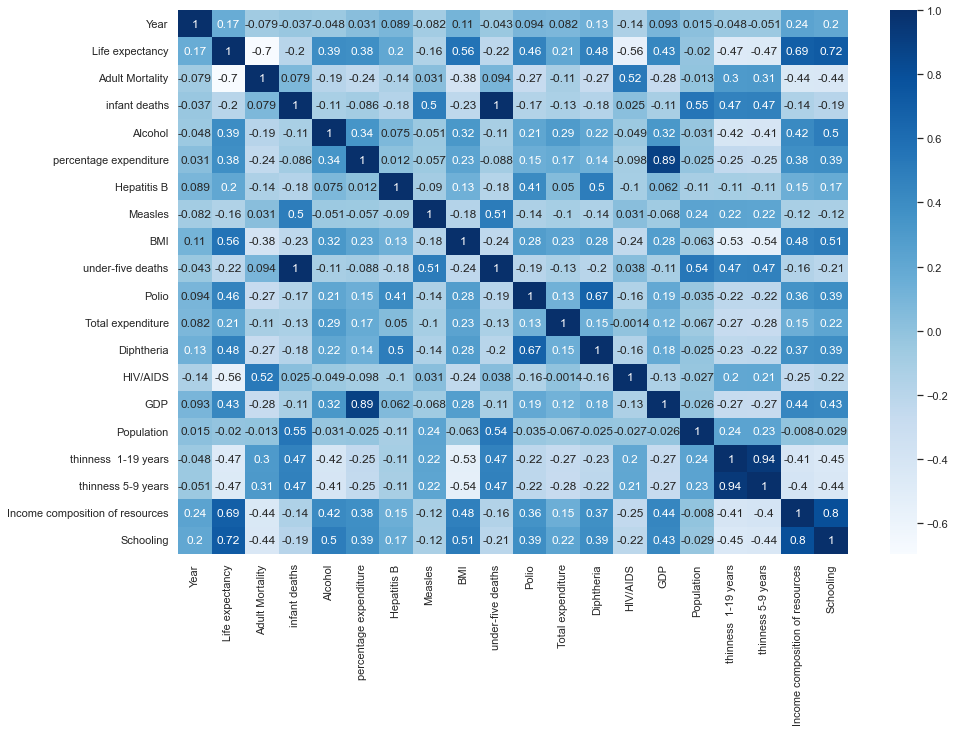

In [117]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr(),annot=True,cmap='Blues')
plt.show()

### Distribution of Life Expectancy

In [118]:
fig=px.histogram(df,x='Life expectancy',template='plotly_dark')
fig.show()

#### This is a Normal Distribution

## Developing vs Developed Countries

In [119]:
fig=px.violin(df,x='Status',y='Life expectancy',color='Status',template='plotly_dark',box=True,title='Life expectancy Based on Countries status')
fig.show()

#### Developed countries have better life expectancy as compared to developing countries

In [120]:
fig=px.line(df.sort_values(by='Year'),x='Year',y='Life expectancy',animation_frame='Country',animation_group='Year',color='Country',markers=True,template='plotly_dark',title='<b> Country wise Life Expectancy over Years')
fig.show()

We have all most all countries that have increased life expectancy with time as observed from graph. 

Although many countries have relatively higher average life expectancy than the other countries

## Let's plot the graph between Life Expectancy versus  Adult Mortality

In [122]:
fig = px.scatter(df , y = 'Adult Mortality', x = 'Life expectancy', color = 'Country', size = 'Life expectancy',template = 'plotly_dark', opacity = 0.6, title = '<b> Life Expectancy Versus Adult Mortality')
fig.show()

From the above graph, we can say that, for every country, Adult Mortality Decreases exponentially with increase in Life expectancy.

### Percentage Expenditure vs Life Expectancy graph

In [123]:
px.scatter(df,x='Life expectancy',y='percentage expenditure',color='Country',size='Year',template='plotly_dark',title='<b> Life Expectancy Versus Percentage expenditure')

From the above graph, we can say that with an increase in Life expectancy, Percentage expenditure also increases exponentially.

#### DECREASE IN INFANT DEATHS INCREASES LIFE EXPECTANCY

In [125]:
px.scatter(df.sort_values(by='Year'),y='infant deaths',x='Life expectancy',template='plotly_dark',size='Year',color='Country',opacity=0.6,title='<b>Life Expectancy Versus Infant Deaths of Countries in every Year')

From the above graph we can say that life expectancy increases with decrease in infant deaths for every country.

In [127]:
px.scatter_3d(df.sort_values(by='Year'),y='Schooling',x='Life expectancy',z='Total expenditure',template='plotly_dark',color='Country',size='Total expenditure')

From the graph mentioned above, we can infer that Schooling and Total expenditure increases with an increase in Life expectancy

In [128]:
px.scatter_3d(df.sort_values(by='Year'),y='Adult Mortality',x='Life expectancy',z='infant deaths',size='Life expectancy',template='plotly_dark',color='Country')

We can say that with an increase in adult Mortality and infant deaths, Life expectancy decreases.

In [129]:
px.scatter(df.sort_values(by='Year'),y='Schooling',x='Life expectancy',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy',title='<b> Life expectancy versus Schooling of countries in every year')

We can say that with an increase in schooling, Life expectancy increases.

In [130]:
px.scatter(df.sort_values(by='Year'),y='Adult Mortality',x='Life expectancy',animation_frame='Year',animation_group='Country',color='Country',size='Life expectancy',opacity=0.6,template='plotly_dark',title='<b> Life Expectancy Versus Adult Mortality in every year')

We can say that with a decrease in Adult Mortality, Life expectancy increases.

In [131]:
px.scatter(df.sort_values(by='Year'),y='BMI',x='Life expectancy',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy',opacity=0.6,title='<b> Life expectancy versus BMI of Countries in every Year')

Nothing significant can be observed from the above graph.

In [132]:
px.scatter(df.sort_values(by='Year'),y='GDP',x='Life expectancy',animation_frame='Year',animation_group='Country',template='plotly_dark',color='Country',size='Life expectancy',title='<b>Life Expectancy Versus GDP of Countries in every Year')

From the graph we can infer that GDP increases exponentially with an increase in Life expectancy.

In [134]:
px.scatter(df, y='Alcohol',x='Life expectancy',template='plotly_dark',color='Country',title='<b>Life Expectancy Versus Alcohol consumption of Countries')

In [136]:
px.scatter(df, y='Hepatitis B', x='Life expectancy',template='plotly_dark',color='Country',title='<b>Life Expectancy Versus Hepatitis B Immunization of Countires')

In [137]:
print(f"Positive and Negative correlation are: ")
df.corr()['Life expectancy'].sort_values(ascending=False)

Positive and Negative correlation are: 


Life expectancy                    1.000000
Schooling                          0.715066
Income composition of resources    0.692483
BMI                                0.559255
Diphtheria                         0.475418
Polio                              0.461574
GDP                                0.430493
Alcohol                            0.391598
percentage expenditure             0.381791
Total expenditure                  0.207981
Hepatitis B                        0.203771
Year                               0.169623
Population                        -0.019638
Measles                           -0.157574
infant deaths                     -0.196535
under-five deaths                 -0.222503
thinness 5-9 years                -0.466629
thinness  1-19 years              -0.472162
HIV/AIDS                          -0.556457
Adult Mortality                   -0.696359
Name: Life expectancy, dtype: float64

In [138]:
print(f"Absolute correlation are: ")
abs(df.corr()['Life expectancy']).sort_values(ascending=False)

Absolute correlation are: 


Life expectancy                    1.000000
Schooling                          0.715066
Adult Mortality                    0.696359
Income composition of resources    0.692483
BMI                                0.559255
HIV/AIDS                           0.556457
Diphtheria                         0.475418
thinness  1-19 years               0.472162
thinness 5-9 years                 0.466629
Polio                              0.461574
GDP                                0.430493
Alcohol                            0.391598
percentage expenditure             0.381791
under-five deaths                  0.222503
Total expenditure                  0.207981
Hepatitis B                        0.203771
infant deaths                      0.196535
Year                               0.169623
Measles                            0.157574
Population                         0.019638
Name: Life expectancy, dtype: float64

**1. Feature Selection: Do various predicting factors which have been chosen initially really affect the Life expectancy? What are the predicting variables actually affecting life expectancy?**

Ans: Yes, from the above graphs, we can see that the featurs such as Schooling, GDP, State, Adult Mortality and Income composition of resources really affect the life expectancy

**2. Should a country having a lower life expectancy value (<65) increase its healthcare expenditure in order to improve its average lifespan?**

Ans: Yes, increase in healthcare will lead to a decrease in Adult Mortality. And from the above graphs, we can see that a decrease in the same will cause an Increase in the Life Expectancy.

**3. How do Infant and Adult mortality rates affect life expectancy?**

Ans: With an increase in Infant Deaths and an increase in Adult mortality, Life expectancy decreases.

**4. Does Life Expectancy have positive or negative correlation with eating habits, lifestyle, exercise, smoking, drinking alcohol etc.**

Ans: From the above correlation table and graphs, we can say that life expectancy has a positive correlation with lifestyle, exercise, smoking and drinking alcohol.

But this does not necessarily mean that Alcohol and Smoking cause an increase in life expectancy. This might be due to a common factor such as total expenditure. As total expenditure increases, alcohol consumption increases but so does schooling and healthcare and hence, Life Expectancy also increases.

**5. What is the impact of schooling on the lifespan of humans?**

Ans: From the above graph and correlation table, we can say that schooling and life expectancy are positively correlated. This is also intuitive as schooling leads to more educated people which should increase the Life Expectancy.

**6. Does Life Expectancy have a positive or negative relationship with drinking alcohol?**

Ans: From the data, we can say that they are positively correlated. But this does not necessarily mean that Alcohol and Smoking cause an increase in life expectancy. This might be due to a common factor such as total expenditure. As total expenditure increases, alcohol consumption increases but so does schooling and healthcare and hence, Life Expectancy also increases.

**7. Do densely populated countries tend to have lower life expectancy?**

Ans: From the above correlation table, we can say that they are very less correlated and hence, the answer would be No.

**8. What is the impact of Immunization coverage on life Expectancy?**

Ans: From the above correlation table and graphs, we can see that an increase in Immunization Coverage (Hepatitis B), life expectancy also increases.

# Feature selection and cross validation

In [140]:
data = df.copy(deep = True)
data = data.drop('Country',axis=1).reset_index()
data.describe()

,index,Year,Life expectancy,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,...,Polio,Total expenditure,Diphtheria,HIV/AIDS,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling
count,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,...,2938.000000,2938.000000,2938.000000,2938.000000,2938.000000,2.938000e+03,2938.000000,2938.000000,2938.000000,2938.000000
mean,1468.500000,2007.518720,69.224932,164.796448,30.303948,4.602861,738.251295,80.940461,2419.592240,38.321247,...,82.550188,5.938190,82.324084,1.742103,7483.158469,1.275338e+07,4.839704,4.870317,0.627551,11.992793
std,848.271871,4.613841,9.507640,124.080302,117.926501,3.916288,1987.914858,22.586855,11467.272489,19.927677,...,23.352143,2.400274,23.640073,5.077785,13136.800417,5.381546e+07,4.394535,4.482708,0.204820,3.264381
min,0.000000,2000.000000,36.300000,1.000000,0.000000,0.010000,0.000000,1.000000,0.000000,1.000000,...,3.000000,0.370000,2.000000,0.100000,1.681350,3.400000e+01,0.100000,0.100000,0.000000,0.000000
25%,734.250000,2004.000000,63.200000,74.000000,0.000000,1.092500,4.685343,80.940461,0.000000,19.400000,...,78.000000,4.370000,78.000000,0.100000,580.486996,4.189172e+05,1.600000,1.600000,0.504250,10.300000
50%,1468.500000,2008.000000,72.000000,144.000000,3.000000,4.160000,64.912906,87.000000,17.000000,43.000000,...,93.000000,5.938190,93.000000,0.100000,3116.561755,3.675929e+06,3.400000,3.400000,0.662000,12.100000
75%,2202.750000,2012.000000,75.600000,227.000000,22.000000,7.390000,441.534144,96.000000,360.250000,56.100000,...,97.000000,7.330000,97.000000,0.800000,7483.158469,1.275338e+07,7.100000,7.200000,0.772000,14.100000
max,2937.000000,2015.000000,89.000000,723.000000,1800.000000,17.870000,19479.911610,99.000000,212183.000000,87.300000,...,99.000000,17.600000,99.000000,50.600000,119172.741800,1.293859e+09,27.700000,28.600000,0.948000,20.700000


## Feature selection using mean/standard deviation metric

In [152]:
from sklearn import linear_model
k = 10
bucket_size,coff_list = int(len(data)/k),[]

for i in range(k):
    train = data.loc[range((i*bucket_size),(i+1)*bucket_size),:]
    train_x = train.loc[:,(train.columns != 'Life expectancy') & (train.columns != 'Status')]
    train_y = train['Life expectancy']
    
        
    model = linear_model.LinearRegression()
    model.fit(train_x, train_y)
    coff_list += [model.coef_]

concat_coeff_list=[]
for i in range(len(coff_list)): concat_coeff_list+=[coff_list[i].tolist()]
coff_list = np.array(concat_coeff_list).T
quality = []

for i in range(len(coff_list)):
    mean,std = coff_list[i].mean(),max(coff_list[i].std(),1e-9)
    quality.append(abs(mean/std))

In [153]:
quality_list = list(enumerate(quality))
quality_list.sort(key=lambda x:x[1], reverse = True)
for i in range(len(quality_list)): print(f'{train_x.columns[quality_list[i][0]]}: {quality_list[i][1]}')

Adult Mortality: 2.7442463813344427
Schooling: 1.755650312672742
Diphtheria: 1.3366337275253535
Income composition of resources: 1.260705799412045
HIV/AIDS: 1.1771813361380388
Polio: 0.9032249954238288
Alcohol: 0.7064664032410582
under-five deaths: 0.7039147347054375
GDP: 0.6999463619847799
Population: 0.5725258327903372
BMI: 0.5524291149902114
Year: 0.43944522411958686
index: 0.41229469302246585
infant deaths: 0.39502443296662987
thinness  1-19 years: 0.369793756768236
Measles: 0.21043927791032097
Hepatitis B: 0.18821377467044256
percentage expenditure: 0.06248171393364178
thinness 5-9 years: 0.061311266476142656
Total expenditure: 0.059398551137077836


In [154]:
from sklearn.tree import DecisionTreeRegressor

dt_regressor = DecisionTreeRegressor()
train_x = train.loc[:, (train.columns!='Life expectancy')& (train.columns != 'Status')].drop(['index'],axis=1)
train_y = train.loc[:, ['Life expectancy']]
dt_regressor = dt_regressor.fit(train_x, train_y)

quality  = dt_regressor.feature_importances_
for i in range(len(coff_list)):coff_list[i]=coff_list[i][0]
    
coff_list = np.array(coff_list).T

quality_list = list(enumerate(quality))
quality_list.sort(key=lambda x:x[1], reverse = True)
for i in range(len(quality_list)): print(f'{train_x.columns[quality_list[i][0]]}: {quality_list[i][1]}')

HIV/AIDS: 0.7069903080570509
Adult Mortality: 0.15786682405654992
Alcohol: 0.038717897982686954
Income composition of resources: 0.022234329448835206
Schooling: 0.014805416393837876
under-five deaths: 0.012003497348382273
infant deaths: 0.010834644740440026
thinness  1-19 years: 0.006743440290362971
Hepatitis B: 0.006302122804418144
Measles: 0.005349272339420199
Year: 0.003988963913271696
percentage expenditure: 0.0037089050060628106
Diphtheria: 0.0035687818162512797
Polio: 0.0017219777762767163
thinness 5-9 years: 0.0014300092395813024
BMI: 0.0013612206353687303
Total expenditure: 0.001158581202166893
GDP: 0.0007610859630808767
Population: 0.00045272098595508075


In [155]:
from sklearn.linear_model import Lasso
from sklearn.feature_selection import SelectFromModel

from sklearn import linear_model
k = 10
bucket_size,coff_list = int(len(data)/k),[]

for i in range(k):
    train_x = train.loc[:, (train.columns!='Life expectancy')& (train.columns != 'Status')].drop(['index'],axis=1)
    train_y = train.loc[:, ['Life expectancy']]
    model_lasso = Lasso(alpha = 1.5)
    model_lasso.fit(train_x,train_y)

    coff_list += [model_lasso.coef_]

concat_coeff_list=[]
for i in range(len(coff_list)): concat_coeff_list+=[coff_list[i].tolist()]
coff_list = np.array(concat_coeff_list).T
quality = []

for i in range(len(coff_list)):
    mean,std = coff_list[i].mean(),max(coff_list[i].std(),1e-9)
    quality.append(abs(mean/std))
    
quality_list = list(enumerate(quality))
quality_list.sort(key=lambda x:x[1], reverse = True)
for i in range(len(quality_list)): print(f'{train_x.columns[quality_list[i][0]]}: {quality_list[i][1]}')

HIV/AIDS: 611990762.2772565
Total expenditure: 279534479.0927762
Alcohol: 181454113.9696641
under-five deaths: 76458857.11803865
Schooling: 73656443.68387328
Adult Mortality: 17038550.43231305
Polio: 16236719.773486124
BMI: 14109800.22038614
Hepatitis B: 10779276.298065934
Diphtheria: 4627583.429002951
percentage expenditure: 1936412.6890459752
GDP: 267078.15010731417
Measles: 7561.47746662359
Population: 59.265420360101245
Year: 0.0
infant deaths: 0.0
thinness  1-19 years: 0.0
thinness 5-9 years: 0.0
Income composition of resources: 0.0


In [169]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso
model = Lasso()
search = GridSearchCV(Lasso(),
                      {'alpha':np.arange(0.1,1,0.1)},
                      cv = 5, scoring="neg_mean_squared_error",verbose=0
                      )
search.fit(train_x, train_y)
quality = [abs(x) for x in search.best_estimator_.coef_]


/Users/samarthpawar/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 9.979e+02, tolerance: 1.951e+00

/Users/samarthpawar/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 8.215e+02, tolerance: 1.353e+00

/Users/samarthpawar/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_coordinate_descent.py:647: ConvergenceWarning:

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.040e+03, tolerance: 1.971e+00

/Users/sam

In [170]:
quality_list = list(enumerate(quality))
quality_list.sort(key=lambda x:x[1], reverse = True)
for i in range(len(quality_list)): print(f'{train_x.columns[quality_list[i][0]]}: {quality_list[i][1]}')

HIV/AIDS: 0.8170763241481594
Schooling: 0.4899320837230433
Total expenditure: 0.47733360059014673
Alcohol: 0.17800475268020827
under-five deaths: 0.07157102193770419
Polio: 0.015064189353139032
Adult Mortality: 0.012110720541722514
Hepatitis B: 0.011909187865533763
Diphtheria: 0.01023534184000479
Year: 0.0061386878211792464
percentage expenditure: 0.0018735475787006156
BMI: 0.0014234957926642783
infant deaths: 0.0007259900233276381
GDP: 0.0002668328271335763
Measles: 1.545399075860782e-05
Population: 5.8313860450049467e-08
thinness  1-19 years: 0.0
thinness 5-9 years: 0.0
Income composition of resources: 0.0


In [171]:
import statsmodels.api as sm
ols = sm.OLS(train_y, train_x).fit()
print(ols.summary())

                                 OLS Regression Results                                
Dep. Variable:        Life expectancy   R-squared (uncentered):                   0.998
Model:                            OLS   Adj. R-squared (uncentered):              0.998
Method:                 Least Squares   F-statistic:                              9415.
Date:                Mon, 22 Aug 2022   Prob (F-statistic):                        0.00
Time:                        09:47:46   Log-Likelihood:                         -709.78
No. Observations:                 293   AIC:                                      1458.
Df Residuals:                     274   BIC:                                      1527.
Df Model:                          19                                                  
Covariance Type:            nonrobust                                                  
                                      coef    std err          t      P>|t|      [0.025      0.975]
--------------------

Assuming the standard p-value of 0.05

Hence, the relevant columns according to the OLS scores are 

    Infant Deaths 
    Thinness 1-19 years
    Percenta
    Schooling
    ge Expnditure
    Hepatitis B
    Thinness 5-19 years
    Polio
    Diptheria
    Alcohol
    Measles
    GDP

In [172]:
from sklearn.feature_selection import SequentialFeatureSelector
model = linear_model.LinearRegression()
sequentialFeatureSelector = SequentialFeatureSelector(model, n_features_to_select=3)
sequentialFeatureSelector.fit(train_x, train_y)
train_x.columns[sequentialFeatureSelector.get_support()]

Index(['Adult Mortality', 'under-five deaths', 'HIV/AIDS'], dtype='object')

# KS distribution test and QQ Plotting

Refernce - https://towardsdatascience.com/comparing-sample-distributions-with-the-kolmogorov-smirnov-ks-test-a2292ad6fee5

In [173]:
from scipy import stats

def cdf(sample, x, sort = False):
    if sort:
        sample.sort()
    cdf = sum(sample <= x)
    cdf = cdf / len(sample)
    return cdf

def ks_norm(sample):
    sample.sort()
    D_ks = [] 
    for x in sample:
        cdf_normal = stats.norm.cdf(x = x, loc = 0, scale = 1)
        cdf_sample = cdf(sample = sample, x  = x)
        D_ks.append(abs(cdf_normal - cdf_sample))
    ks_stat = max(D_ks)
    p_value = stats.kstwo.sf(ks_stat, len(sample))
    return {"ks_stat": ks_stat, "p_value" : p_value}    

def gaussian_fit(data):
    data=np.array(data)
    mean = np.mean(data)
    sd = np.std(data)
    if sd == 0 : sd = 1
    return (data - mean)/sd

col_dist = {}
for col in train_x.columns:
    col_dist[col] = ks_norm(gaussian_fit(train_x[col].values))
    
normally_distributed = [col for col in col_dist if col_dist[col]['p_value']>0.05]
normally_not_distributed = [col for col in col_dist if col_dist[col]['p_value']<=0.05]

for col in normally_distributed:
    print(f"{col}: ks = {col_dist[col]['ks_stat']:.4f} (p-value = {col_dist[col]['p_value']:.3e}, is normal = {col_dist[col]['p_value'] > 0.05})")
print()
for col in normally_not_distributed:
    print(f"{col}: ks = {col_dist[col]['ks_stat']:.4f} (p-value = {col_dist[col]['p_value']:.3e}, is normal = {col_dist[col]['p_value'] > 0.05})")


Year: ks = 0.0873 (p-value = 2.155e-02, is normal = False)
Adult Mortality: ks = 0.1417 (p-value = 1.358e-05, is normal = False)
infant deaths: ks = 0.1981 (p-value = 1.481e-10, is normal = False)
Alcohol: ks = 0.1506 (p-value = 2.892e-06, is normal = False)
percentage expenditure: ks = 0.2772 (p-value = 2.117e-20, is normal = False)
Hepatitis B: ks = 0.2173 (p-value = 1.263e-12, is normal = False)
Measles: ks = 0.3652 (p-value = 1.546e-35, is normal = False)
BMI: ks = 0.1408 (p-value = 1.571e-05, is normal = False)
under-five deaths: ks = 0.2009 (p-value = 7.749e-11, is normal = False)
Polio: ks = 0.2291 (p-value = 5.320e-14, is normal = False)
Total expenditure: ks = 0.1741 (p-value = 3.075e-08, is normal = False)
Diphtheria: ks = 0.2334 (p-value = 1.595e-14, is normal = False)
HIV/AIDS: ks = 0.3958 (p-value = 6.789e-42, is normal = False)
GDP: ks = 0.3026 (p-value = 2.691e-24, is normal = False)
Population: ks = 0.3087 (p-value = 2.725e-25, is normal = False)
thinness  1-19 years: 

In [174]:
df.columns

Index(['Country', 'Year', 'Status', 'Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'],
      dtype='object')

/var/folders/_s/_grtxcys6dj7q0d1g7zlpylr0000gn/T/ipykernel_4532/892100957.py:12: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



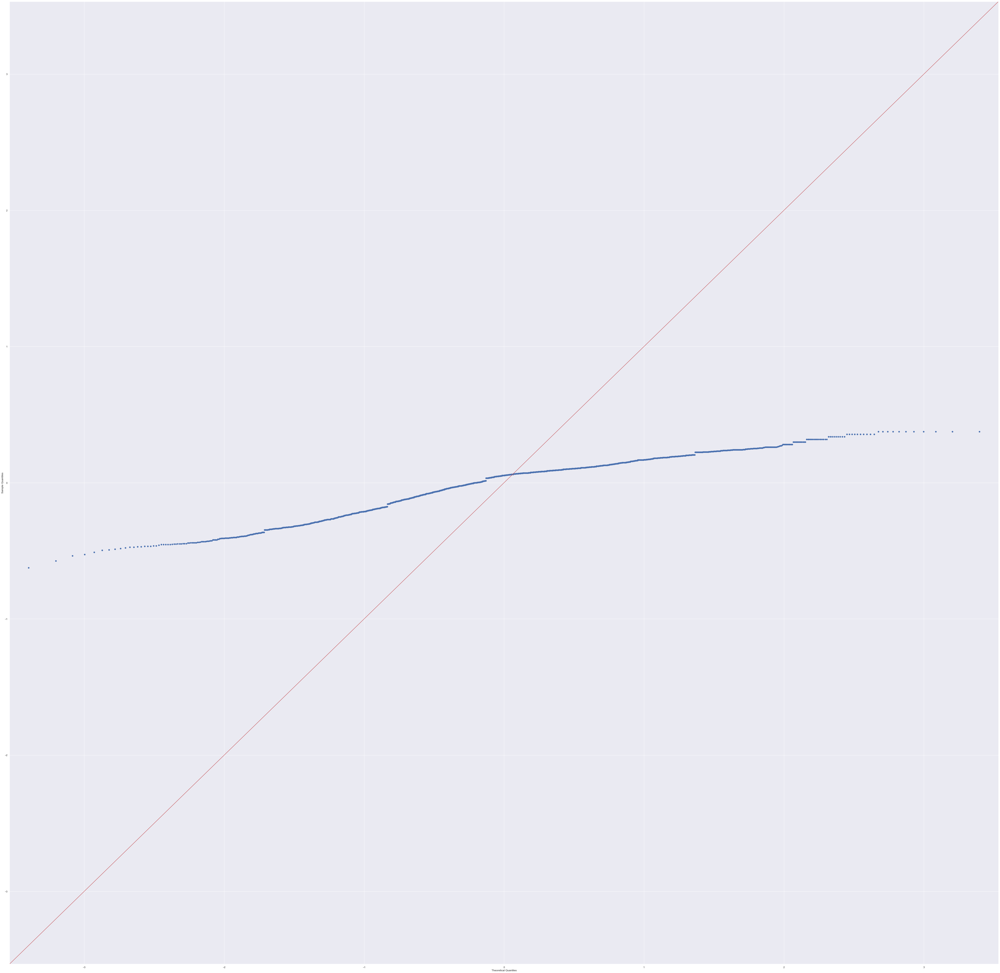

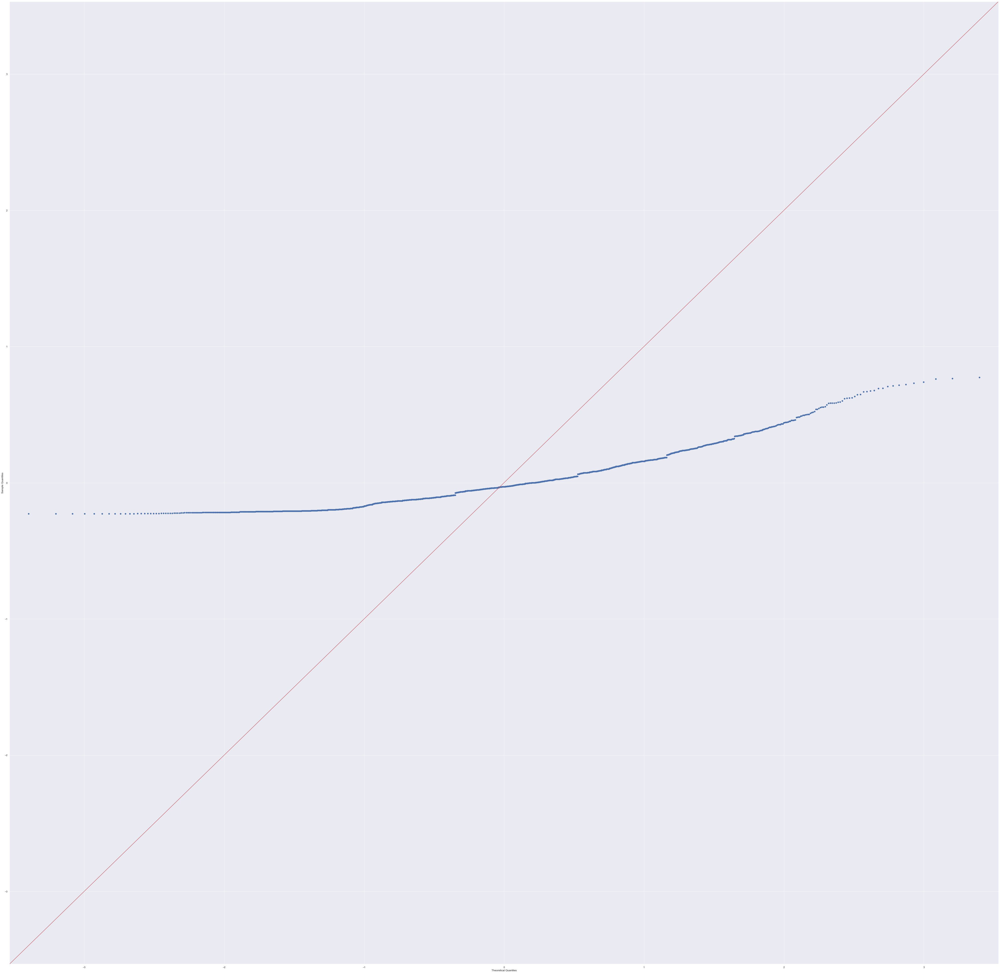

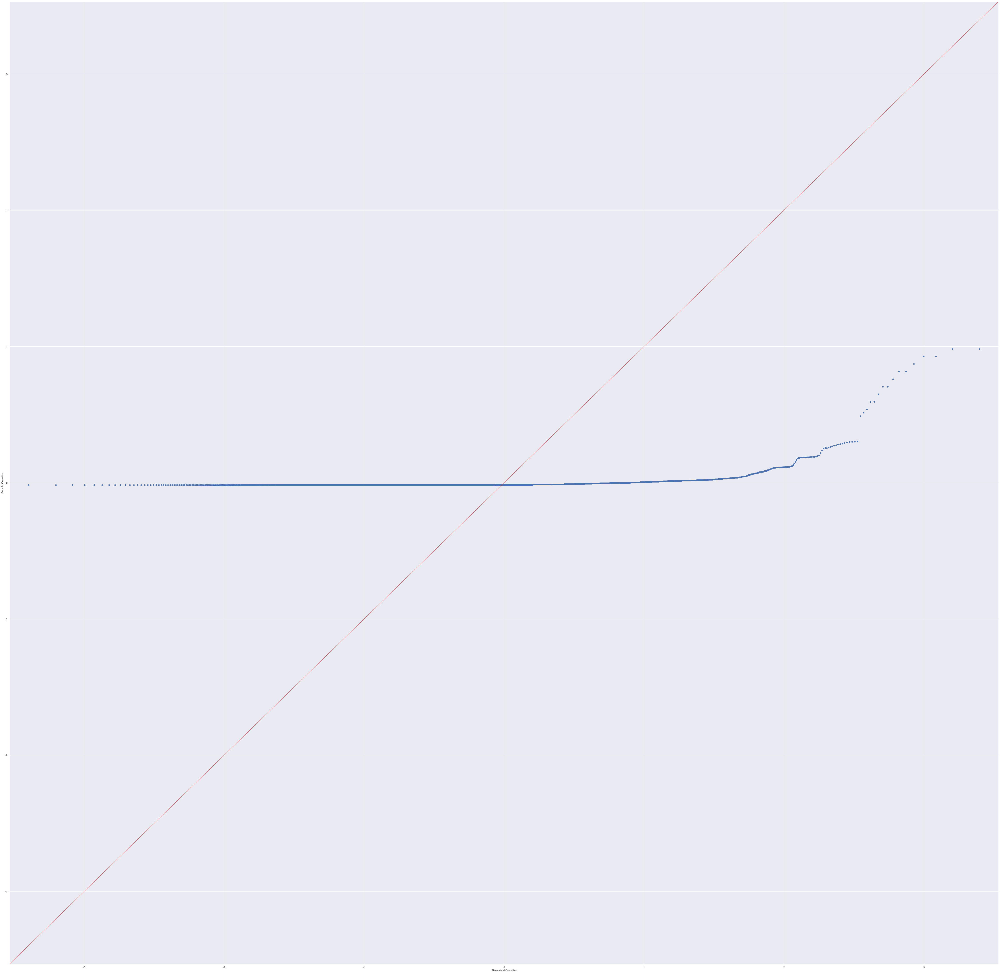

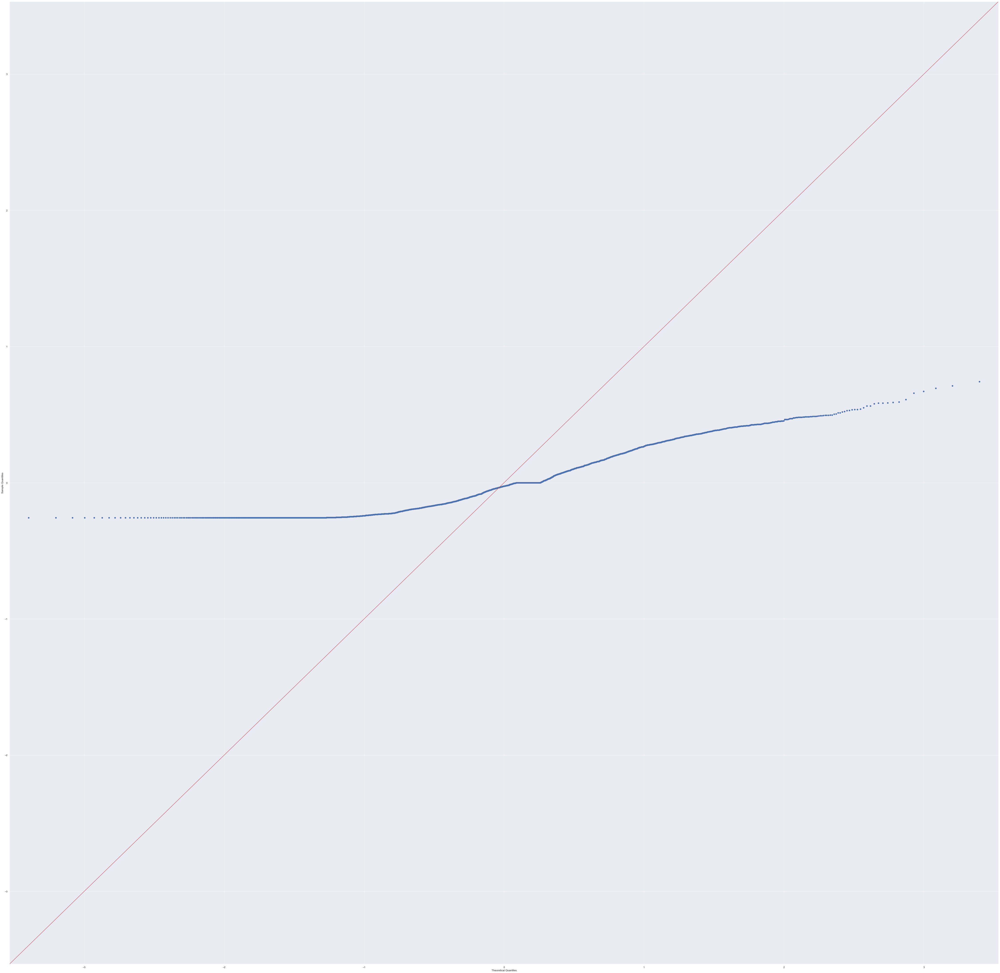

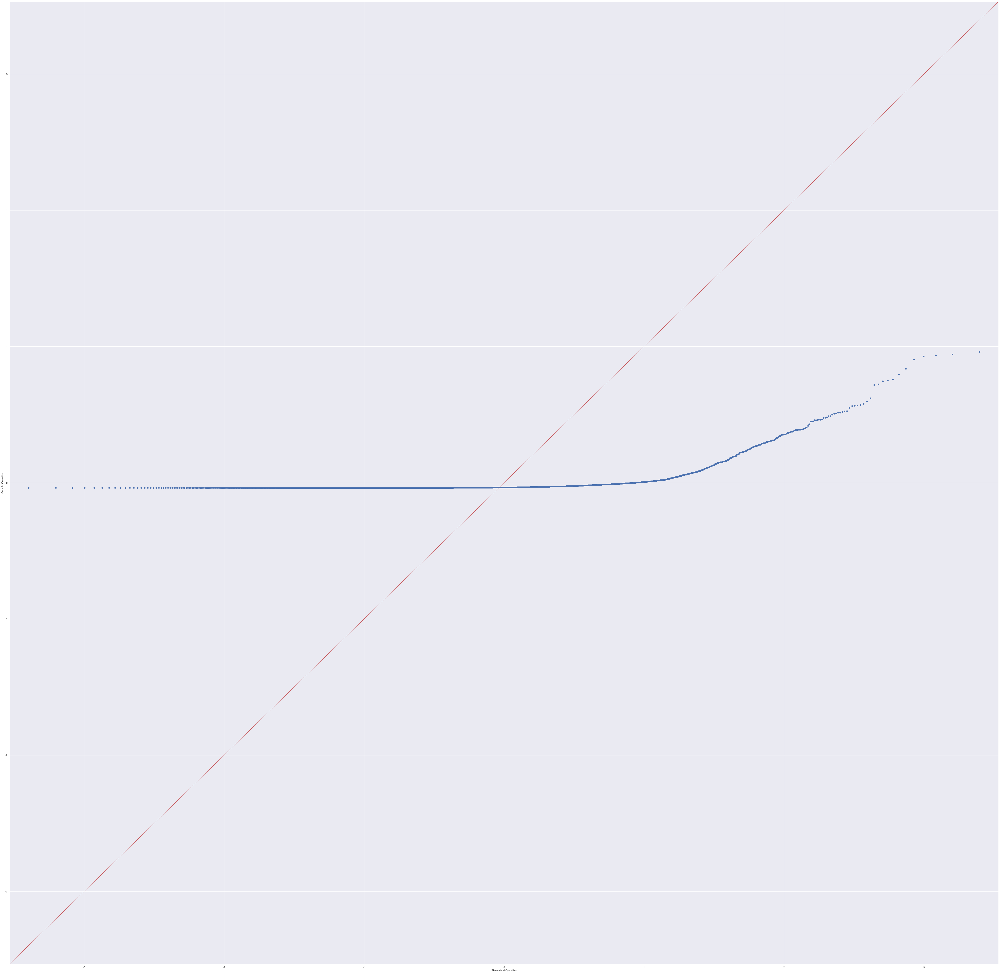

...

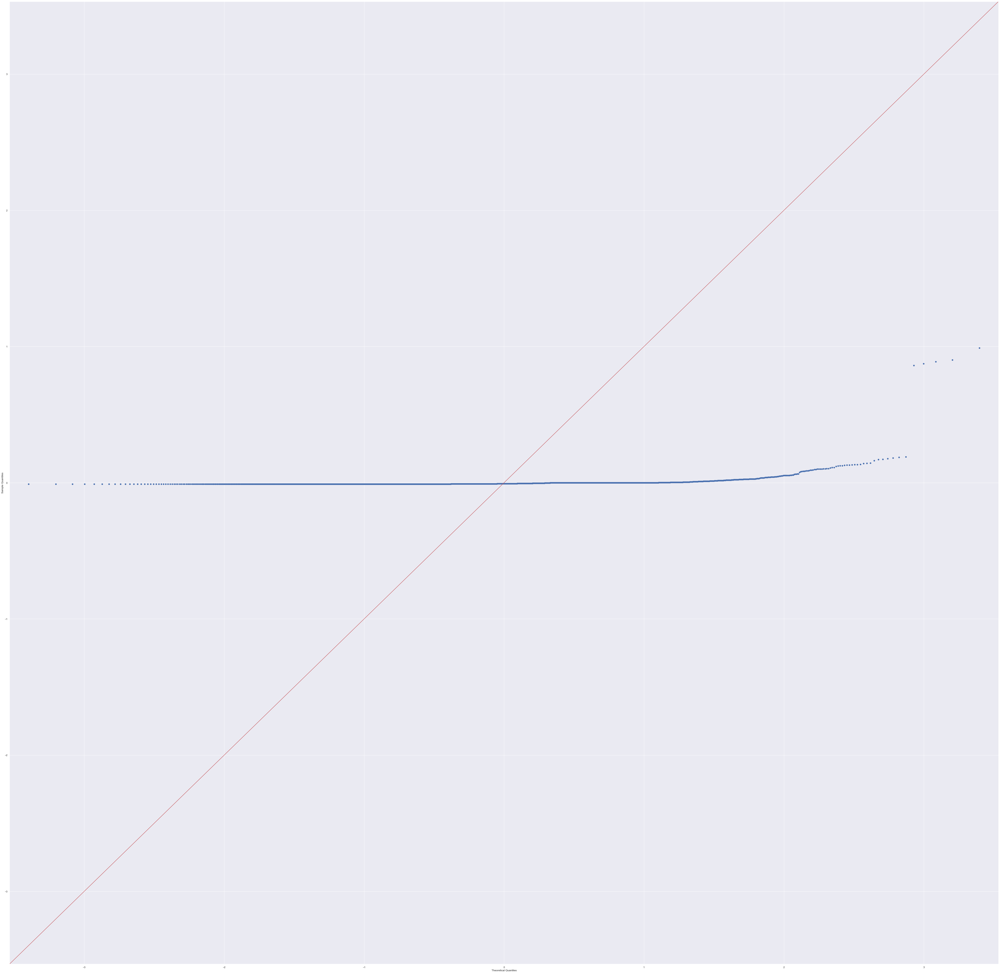

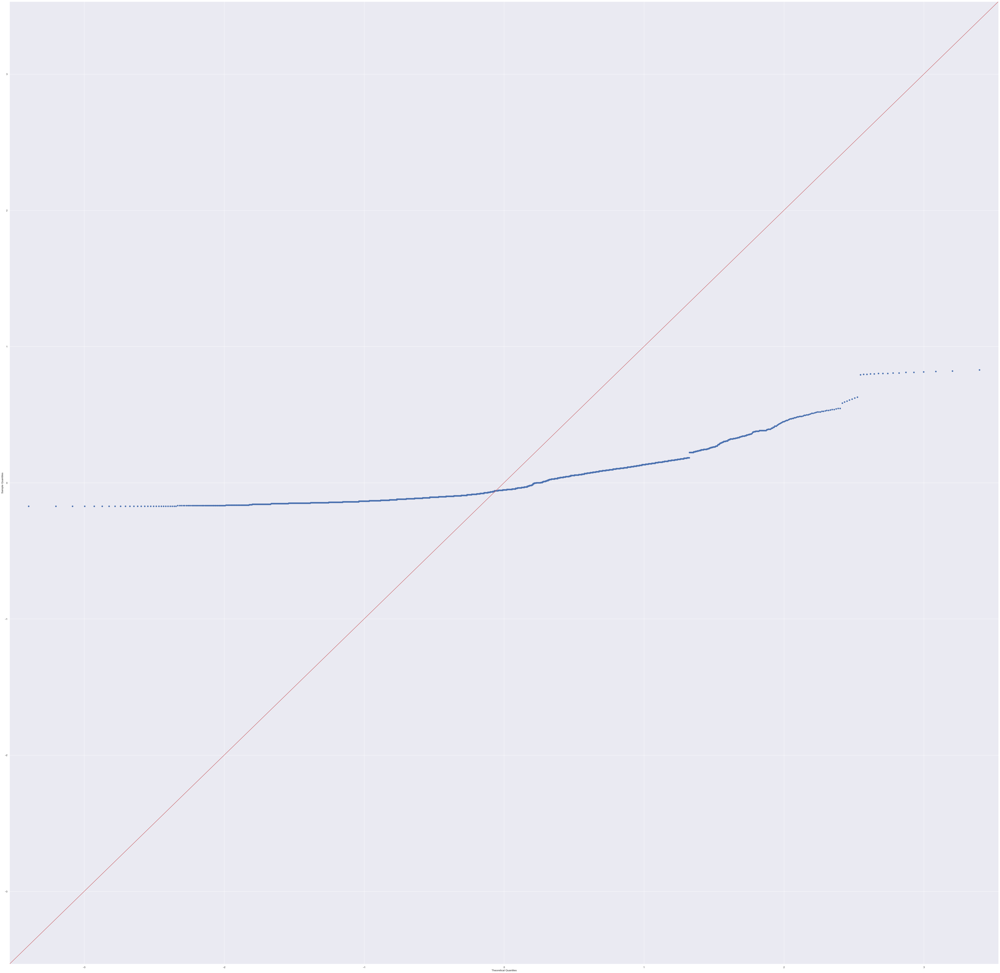

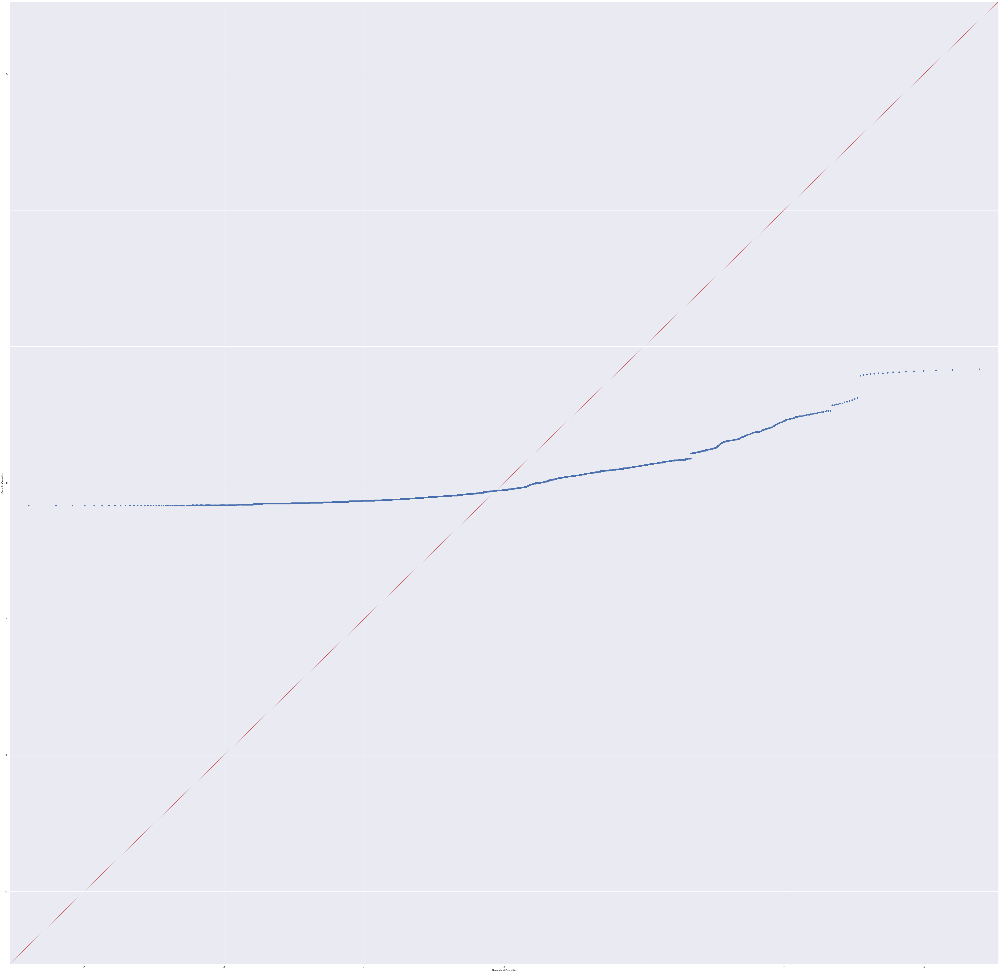

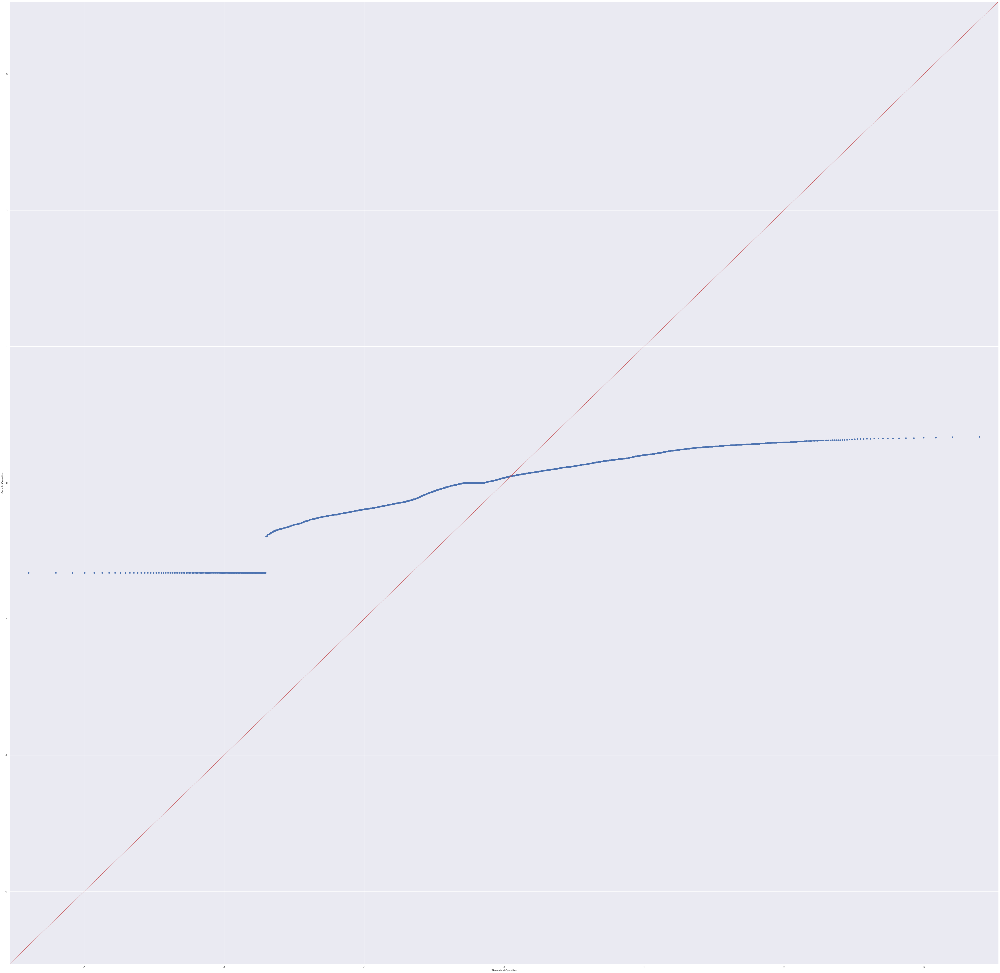

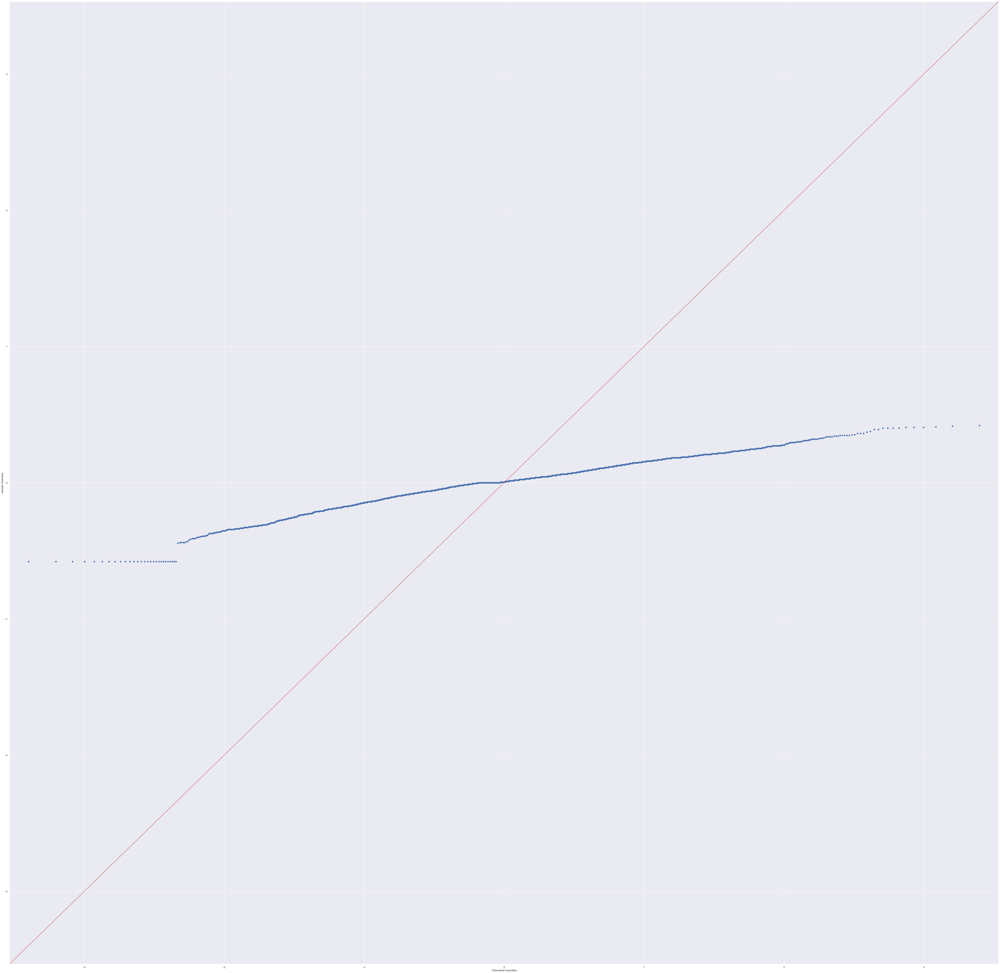

In [176]:
import statsmodels.api as sm
import matplotlib.pyplot as plt

df_modif = pd.read_csv('./Life Expectancy Data.csv')
column_names_corrected = {}
df_modif.columns = df_modif.columns.str.strip()
df_modif = df_modif.loc[:,['Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling']]
df_modif=df_modif.fillna(data.mean())
df_modif = df_modif.select_dtypes(exclude="object")
df_modif = (df_modif - df_modif.mean())/(df_modif.max() - df_modif.min())

# #create Q-Q plot with 45-degree line added to plot
for i in ['Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'] :
    
    fig = sm.qqplot(df_modif[i], line='45')
    plt.show()

Therefore the columns with normal distribution ($KS_{p\_value} > 0.05$) are 
    
    YEAR
    BMI
    TOTAL EXPENDITURE

# Pipelining and Scaling

In [185]:
from sklearn.preprocessing import StandardScaler
raw_data = pd.read_csv('./Life Expectancy Data.csv')
raw_data.columns = raw_data.columns.str.strip()

raw_data_part1 = raw_data.loc[:,['Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling']]

raw_data_part1=raw_data_part1.fillna(data.mean())


ss = StandardScaler()
updated_data = ss.fit_transform(raw_data_part1)
updated_data

/var/folders/_s/_grtxcys6dj7q0d1g7zlpylr0000gn/T/ipykernel_4532/2582994728.py:11: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



array([[-0.44444792,  0.79158632,  0.26882378, ...,  2.77327898,
        -0.72540055, -0.57993072],
       [-0.98094995,  0.85607167,  0.28578638, ...,  2.81790246,
        -0.74005007, -0.61056961],
       [-0.98094995,  0.83188966,  0.30274898, ...,  2.86252595,
        -0.7693491 , -0.6412085 ],
       ...,
       [-2.56941673, -0.73994077, -0.04498439, ..., -0.79659991,
        -0.97932554, -0.61056961],
       [-2.5168185 ,  4.20124926, -0.04498439, ..., -0.70735294,
        -0.97932554, -0.6718474 ],
       [-2.44318096,  4.03197521, -0.05346569, ...,  1.41226265,
        -0.94514333, -0.6718474 ]])

In [186]:
data_scaled = pd.DataFrame(updated_data, columns = ['Life expectancy', 'Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'])

for i in ['Country', 'Year','Status']:
    data_scaled[i] = raw_data[i]

In [188]:
data_scaled['BMI']

0      -0.964715
1      -0.989810
2      -1.014905
3      -1.040000
4      -1.060076
          ...   
2933   -0.563194
2934   -0.583270
2935   -0.603346
2936   -0.623422
2937   -0.643498
Name: BMI, Length: 2938, dtype: float64

### Pipelining

For cleaning of the data

In [192]:
from sklearn.base import BaseEstimator, TransformerMixin

class Cleaning(BaseEstimator,TransformerMixin):
    
    def __init__(self):
        pass
    
    def fit(self,X,y=None):
        return self
    
    def transform(self,X):
        X.columns = X.columns.str.strip()
        X = X.replace(0, np.nan)
        return X

For imputing the data

In [193]:
class Imputing(BaseEstimator,TransformerMixin):
    
    def __init__(self):
        pass
    
    def fit(self,X,y=None):
        return self
    
    def transform(self,X):
        
        # replace 0 with Nan in X
        X.replace(0, np.nan, inplace=True)

        imputer = KNNImputer(n_neighbors=3)

        X['Life expectancy']=imputer.fit_transform(X[['Life expectancy']])
        X['Adult Mortality']=imputer.fit_transform(X[['Adult Mortality']])
        X['Alcohol']=imputer.fit_transform(X[['Alcohol']])
        X['Hepatitis B']=imputer.fit_transform(X[['Hepatitis B']])
        X['BMI']=imputer.fit_transform(X[['BMI']])
        X['Polio']=imputer.fit_transform(X[['Polio']])
        X['Total expenditure']=imputer.fit_transform(X[['Total expenditure']])
        X['Diphtheria']=imputer.fit_transform(X[['Diphtheria']])
        X['GDP']=imputer.fit_transform(X[['GDP']])
        X['Population']=imputer.fit_transform(X[['Population']])
        X['thinness  1-19 years']=imputer.fit_transform(X[['thinness  1-19 years']])
        X['thinness 5-9 years']=imputer.fit_transform(X[['thinness 5-9 years']])
        X['Income composition of resources']=imputer.fit_transform(X[['Income composition of resources']])
        X['Schooling']=imputer.fit_transform(X[['Schooling']])
        X['infant deaths']=imputer.fit_transform(X[['infant deaths']])
        X['percentage expenditure']=imputer.fit_transform(X[['percentage expenditure']])
        X['under-five deaths']=imputer.fit_transform(X[['under-five deaths']])
        X['Measles']=imputer.fit_transform(X[['Measles']])

        return X

For scaling the data

In [194]:
class Scaling(BaseEstimator,TransformerMixin):
    
    def __init__(self):
        pass
    
    def fit(self,X,y=None):
        return self
    
    def transform(self,X):
        
        temp = X.loc[:,['Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling']]

        scaler = StandardScaler()
        scaled = scaler.fit_transform(temp)

        data = pd.DataFrame(scaled, columns = ['Adult Mortality',
       'infant deaths', 'Alcohol', 'percentage expenditure', 'Hepatitis B',
       'Measles', 'BMI', 'under-five deaths', 'Polio', 'Total expenditure',
       'Diphtheria', 'HIV/AIDS', 'GDP', 'Population', 'thinness  1-19 years',
       'thinness 5-9 years', 'Income composition of resources', 'Schooling'])
        
        for i in ['Country', 'Year', 'Status', 'Life expectancy']: data[i] = X[i]
            
        return data

In [195]:
from sklearn.pipeline import Pipeline

data = pd.read_csv('./Life Expectancy Data.csv')

pipeline = Pipeline([
    ('Cleaning of Data',Cleaning()),
    ('Imputing of Data', Imputing()),
    ('Scaling of data', Scaling())
])

preprocessed_data = pipeline.fit_transform(data)
preprocessed_data

,Adult Mortality,infant deaths,Alcohol,percentage expenditure,Hepatitis B,Measles,BMI,under-five deaths,Polio,Total expenditure,...,GDP,Population,thinness 1-19 years,thinness 5-9 years,Income composition of resources,Schooling,Country,Year,Status,Life expectancy
0,0.791586,0.166792,-1.172958,-0.441162,-0.705861,-0.218961,-0.964715,0.161857,-3.278638,0.925806,...,-0.525248,0.389975,2.813130,2.773279,-1.166745,-0.661900,Afghanistan,2015,Developing,65.0
1,0.856072,0.183986,-1.172958,-0.440012,-0.838704,-0.277358,-0.989810,0.180797,-1.051482,0.934140,...,-0.523083,-0.230936,2.881408,2.817902,-1.186251,-0.694748,Afghanistan,2014,Developing,59.9
2,0.831890,0.201181,-1.172958,-0.440168,-0.750142,-0.282828,-1.014905,0.199736,-0.880163,0.913306,...,-0.521632,0.352715,2.926927,2.862526,-1.225264,-0.727596,Afghanistan,2013,Developing,59.9
3,0.864132,0.226973,-1.172958,-0.437623,-0.617299,-0.074910,-1.040000,0.224989,-0.666013,1.075815,...,-0.518723,-0.168315,2.972446,2.929461,-1.270779,-0.760444,Afghanistan,2012,Developing,59.5
4,0.888314,0.244167,-1.172958,-0.474055,-0.573018,-0.054974,-1.060076,0.250242,-0.623183,0.804966,...,-0.564893,-0.181666,3.040724,2.974085,-1.329297,-0.858989,Afghanistan,2011,Developing,59.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2933,4.499494,-0.134114,-0.062024,0.000000,-0.573018,-0.318024,-0.563194,-0.096986,-0.666013,0.496616,...,-0.535137,0.000449,1.037896,1.010651,-1.634896,-0.957533,Zimbabwe,2004,Developing,44.3
2934,4.435009,-0.142711,-0.138640,0.000000,-3.274163,-0.232723,-0.583270,-0.103299,-3.235808,0.242435,...,-0.535214,-0.002221,1.128934,1.122210,-1.563373,-0.858989,Zimbabwe,2003,Developing,44.5
2935,-0.739941,-0.151308,-0.044146,0.000000,-0.351612,-0.293942,-0.603346,-0.109612,-0.409034,0.246602,...,-0.565364,-0.234691,-0.828375,-0.796600,-1.504854,-0.694748,Zimbabwe,2002,Developing,44.8
2936,4.201249,-0.151308,-0.736246,0.000000,-0.218769,-0.274094,-0.623422,-0.115925,-0.280544,0.092426,...,-0.527964,-0.007196,-0.737337,-0.707353,-1.504854,-0.760444,Zimbabwe,2001,Developing,45.3
